In [35]:
import pickle


In [2]:
from sports.configs.soccer import SoccerPitchConfiguration
import pickle

CONFIG = SoccerPitchConfiguration()

In [4]:

# Load the data
with open('/home/shishirr/Desktop/Applied_Data_Science_and_Artificial_Intelligence/Project/Sports-Analysis/Soccer_Analytics/core/detections.pkl', 'rb') as f:
    data = pickle.load(f)


In [5]:
! pip install mplsoccer

Defaulting to user installation because normal site-packages is not writeable


In [6]:
import pandas as pd
import numpy as np



In [7]:
frames = []

In [8]:
# Iterate through data to get the x and y cordinates of each team
for frame in data:
    a_x = [] # x coordinates of team a
    a_y = [] # y coordinates of team a

    b_x = [] # x coordinates of team b
    b_y = [] # y coordinates of team b
    ball_x = []
    ball_y = []
    for obj in frame:
        if obj[1] == 1:
            a_x.append(obj[2][0])
            a_y.append(obj[2][1])
        elif obj[1] == 2:
            b_x.append(obj[2][0])
            b_y.append(obj[2][1])
        elif obj[1] == 0:
            ball_x.append(obj[2][0])
            ball_y.append(obj[2][1])
    frames.append((a_x, a_y, b_x, b_y, ball_x, ball_y))

    


In [9]:
length = len(frames[0])
print(length)
# print opp in the first frame
print(frames[0][4])
print(frames[0])

6
[47.552267562998864]
([58.2341618070309, 52.491845634333615, 64.22598968462398, 64.33760656804897, 58.16300372290341, 55.28340627444203, 71.13853791131652], [50.28769044111598, 40.646350634482594, 43.45088481632129, 27.967116034891333, 34.20938037888111, 15.594338281305838, 15.02992235289383], [43.27445106542627, 47.1861669666632, 57.56244507247654, 46.41517601261521, 60.58855079480321, 64.19454529683848, 64.04355540467188, 67.00114299842136, 52.87532653144199, 50.7793445189628], [34.75520711763632, 53.092736723532454, 29.90773684785537, 17.997330618204987, 36.767934644940205, 47.818332406854374, 17.344643761141164, 4.059622566228676, -0.7545173665621832, 0.06323498171225594], [47.552267562998864], [53.47423683005998])


In [10]:
df = pd.DataFrame({
    'x': frames[0][0] + frames[0][2],
    'y': frames[0][1] + frames[0][3],
    'team': ['a']*len(frames[0][0]) + ['b']*len(frames[0][2])
})

In [11]:
df.head()

,x,y,team
0,58.234162,50.287690,a
1,52.491846,40.646351,a
2,64.225990,43.450885,a
3,64.337607,27.967116,a
4,58.163004,34.209380,a


In [12]:
points = np.column_stack((df['x'], df['y']))

In [13]:
## sepearte data frame for team a and team b
df_a = df[df['team'] == 'a']
df_b = df[df['team'] == 'b']

In [14]:
points

array([[ 5.82341618e+01,  5.02876904e+01],
       [ 5.24918456e+01,  4.06463506e+01],
       [ 6.42259897e+01,  4.34508848e+01],
       [ 6.43376066e+01,  2.79671160e+01],
       [ 5.81630037e+01,  3.42093804e+01],
       [ 5.52834063e+01,  1.55943383e+01],
       [ 7.11385379e+01,  1.50299224e+01],
       [ 4.32744511e+01,  3.47552071e+01],
       [ 4.71861670e+01,  5.30927367e+01],
       [ 5.75624451e+01,  2.99077368e+01],
       [ 4.64151760e+01,  1.79973306e+01],
       [ 6.05885508e+01,  3.67679346e+01],
       [ 6.41945453e+01,  4.78183324e+01],
       [ 6.40435554e+01,  1.73446438e+01],
       [ 6.70011430e+01,  4.05962257e+00],
       [ 5.28753265e+01, -7.54517367e-01],
       [ 5.07793445e+01,  6.32349817e-02]])

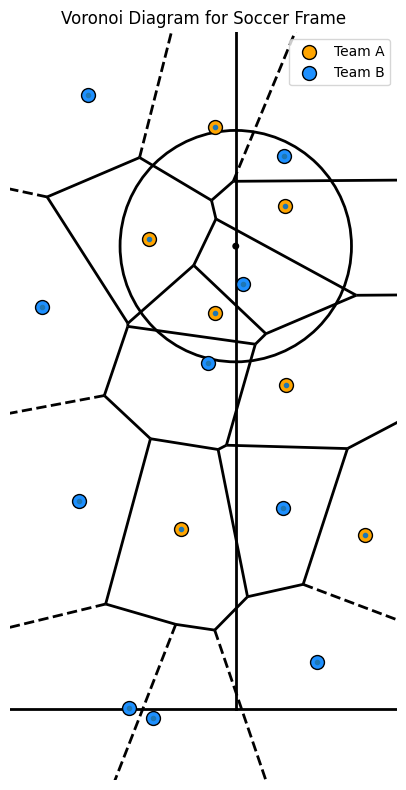

In [15]:
import matplotlib.pyplot as plt
from mplsoccer.pitch import Pitch
from scipy.spatial import Voronoi, voronoi_plot_2d

# Extract x, y coordinates for both teams from the first frame
frame = frames[0]

# Team A coordinates
a_x = np.array(frame[0])
a_y = np.array(frame[1])

# Team B coordinates
b_x = np.array(frame[2])
b_y = np.array(frame[3])

# Combine x, y coordinates for all points
all_x = np.concatenate([a_x, b_x])
all_y = np.concatenate([a_y, b_y])

# Create a label array for teams
teams = ['a'] * len(a_x) + ['b'] * len(b_x)

# Create the Voronoi diagram using scipy
points = np.column_stack((all_x, all_y))
vor = Voronoi(points)

# Plot the pitch
pitch = Pitch(pitch_type='statsbomb', pitch_color='white', line_color='black')
fig, ax = pitch.draw(figsize=(12, 8))

# Plot Voronoi diagram
voronoi_plot_2d(vor, ax=ax, show_vertices=False, line_colors='k', line_width=2)

# Scatter players
ax.scatter(a_x, a_y, color='orange', edgecolor='k', s=100, label='Team A')
ax.scatter(b_x, b_y, color='dodgerblue', edgecolor='k', s=100, label='Team B')

# Set legend and labels
ax.legend()
plt.title('Voronoi Diagram for Soccer Frame')
plt.show()

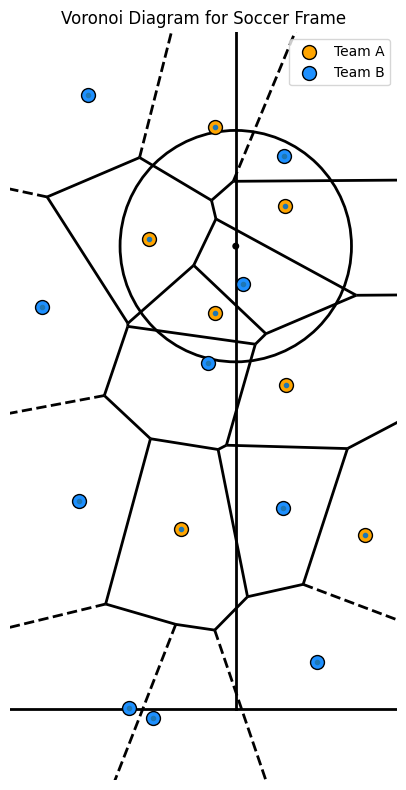

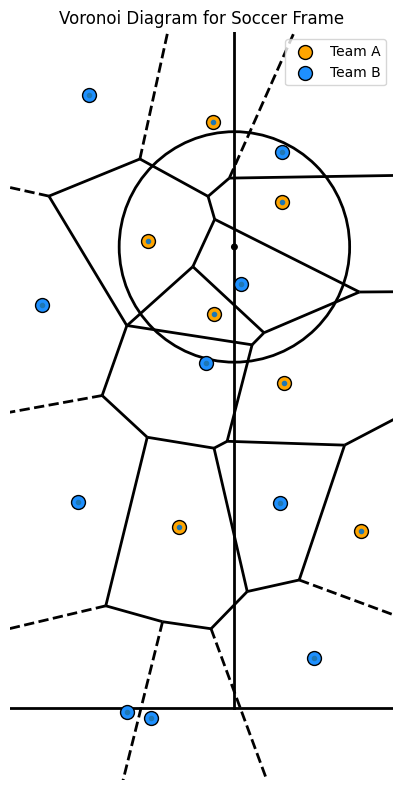

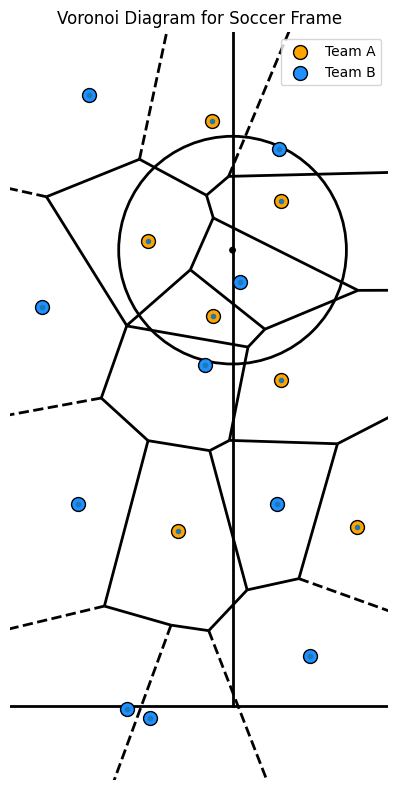

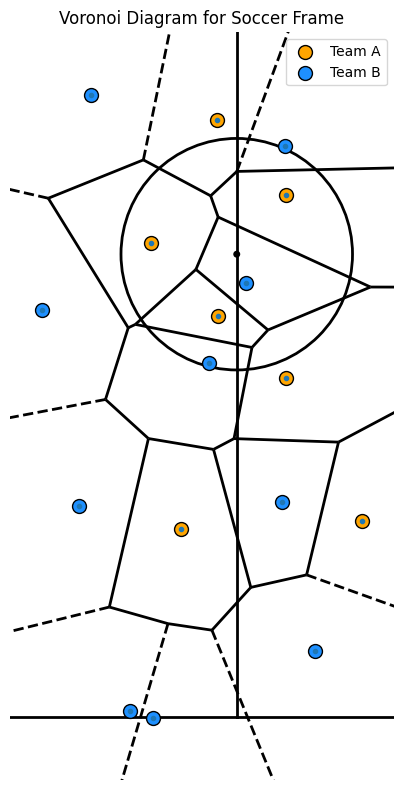

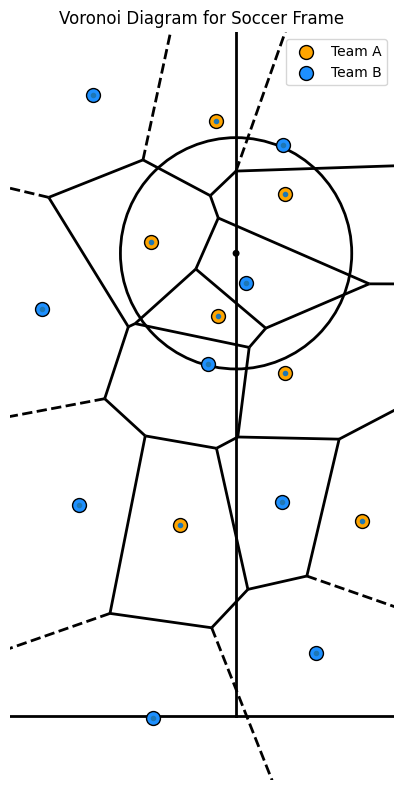

...

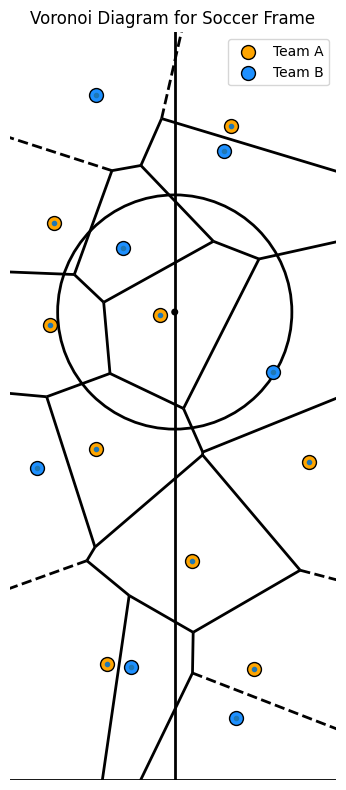

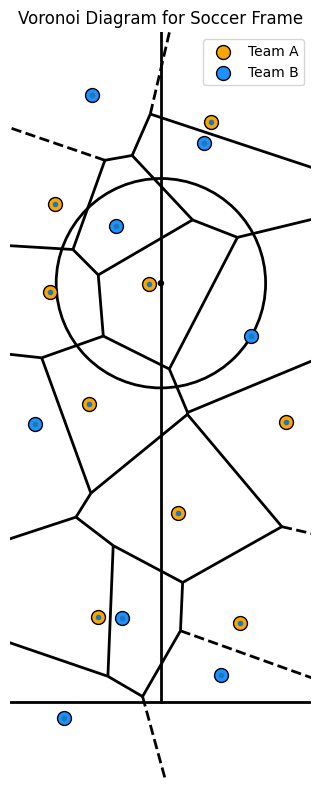

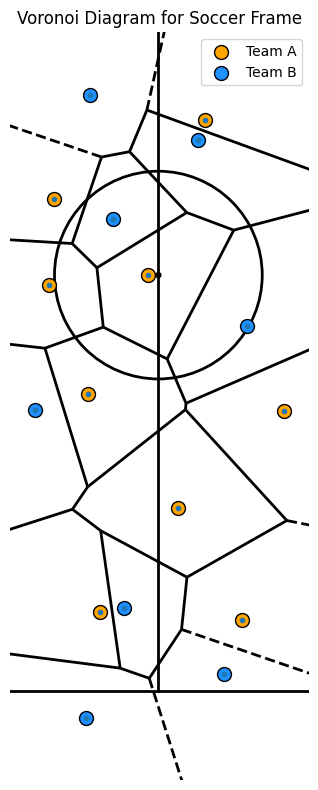

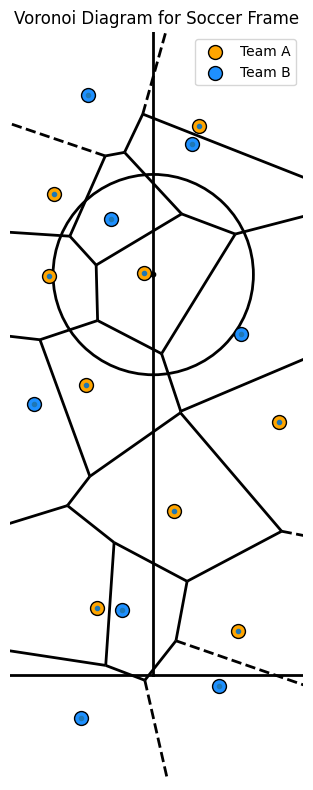

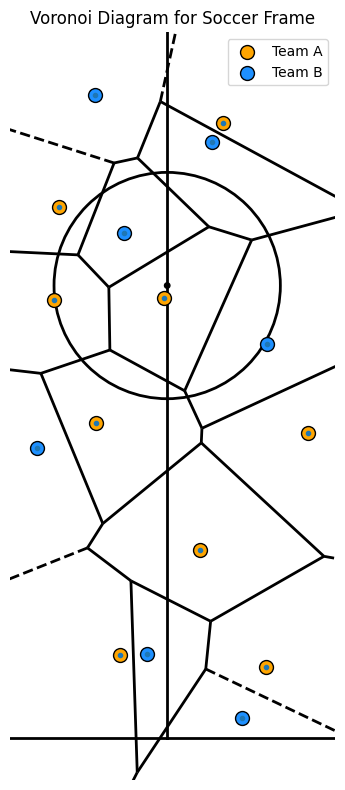

In [76]:
# repeat the same for all frames
for frame in frames:
    # Team A coordinates
    a_x = np.array(frame[0])
    a_y = np.array(frame[1])

    # Team B coordinates
    b_x = np.array(frame[2])
    b_y = np.array(frame[3])

    # Combine x, y coordinates for all points
    all_x = np.concatenate([a_x, b_x])
    all_y = np.concatenate([a_y, b_y])

    # Create a label array for teams
    teams = ['a'] * len(a_x) + ['b'] * len(b_x)

    # Create the Voronoi diagram using scipy
    points = np.column_stack((all_x, all_y))
    vor = Voronoi(points)

    # Plot the pitch
    pitch = Pitch(pitch_type='statsbomb', pitch_color='white', line_color='black')
    fig, ax = pitch.draw(figsize=(12, 8))

    # Plot Voronoi diagram
    voronoi_plot_2d(vor, ax=ax, show_vertices=False, line_colors='k', line_width=2)

    # Scatter players
    ax.scatter(a_x, a_y, color='orange', edgecolor='k', s=100, label='Team A')
    ax.scatter(b_x, b_y, color='dodgerblue', edgecolor='k', s=100, label='Team B')

    # Set legend and labels
    ax.legend()
    plt.title('Voronoi Diagram for Soccer Frame')
    plt.show()

    